In [638]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
%matplotlib inline
import plotly.offline as pyo
pyo.init_notebook_mode()

In [2480]:
calender = pd.read_csv('data/calendar.csv')
# listings = pd.read_csv('data/listings.csv')
# reviews = pd.read_csv('data/reviews.csv')

In [19]:
# get data shapes
print(calender.shape)
print(listings.shape)
print(reviews.shape)

(7262779, 7)
(19896, 74)
(639522, 6)


In [17]:
calender.head()

,listing_id,date,available,price,adjusted_price,minimum_nights,maximum_nights
0,353640,2020-10-17,f,$80.00,$80.00,2.0,1125.0
1,21974,2020-10-13,f,$55.00,$55.00,3.0,90.0
2,21974,2020-10-14,f,$55.00,$55.00,3.0,90.0
3,21974,2020-10-15,f,$55.00,$55.00,3.0,90.0
4,21974,2020-10-16,f,$55.00,$55.00,3.0,90.0


In [20]:
# unique listings
calender.listing_id.nunique()

19896

Future booking trends.

In [ ]:
calender.date = pd.to_datetime(calender.date)
calender.available.replace({'f':1,'t':0}, inplace=True)

In [2482]:
x = calender.set_index('date').resample('MS').available.mean()
fig = go.Figure()
fig.add_trace(go.Scatter(x=x.index, y=x.values, marker_color='#23aaff'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     tickvals=x.index,
                     ticktext=['Oct 2020', 'Nov 2020', 'Dec 2020', 'Jan 2021','Feb 2021','Mar 2021','Apr 2021','May 2021',
                              'Jun 2021','Jul 2021','Aug 2021','Sep 2021','Oct 2021'],
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

In [21]:
listings.head()

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,21974,https://www.airbnb.com/rooms/21974,20201012033127,2020-10-13,Comf. double room/private bathroom,It is private double room with private bathroo...,NaN,https://a0.muscache.com/pictures/8e7c8694-f5ea...,73163,https://www.airbnb.com/users/show/73163,...,10.0,10.0,10.0,HUTB-120440,f,3,1,2,0,0.05
1,23197,https://www.airbnb.com/rooms/23197,20201012033127,2020-10-17,Forum DeLuxe 5 mins Walk To CCIB Center & Sea★,"Beautiful apartment, large terrace, 5 minutes ...",Strategically located in the Parc del Fòrum ar...,https://a0.muscache.com/pictures/738532/806da1...,90417,https://www.airbnb.com/users/show/90417,...,10.0,9.0,9.0,HUTB-005057,t,2,2,0,0,0.45
2,32711,https://www.airbnb.com/rooms/32711,20201012033127,2020-10-15,Sagrada Familia area - Còrsega 1,A lovely two bedroom apartment only 250 m from...,What's nearby <br />This apartment is located...,https://a0.muscache.com/pictures/357b25e4-f414...,135703,https://www.airbnb.com/users/show/135703,...,10.0,10.0,9.0,HUTB-001722,t,5,5,0,0,0.56
3,34241,https://www.airbnb.com/rooms/34241,20201012033127,2020-10-12,Private Double room - Plaza Real,<b>The space</b><br />It is a Private double r...,NaN,https://a0.muscache.com/pictures/2437facc-2fe7...,73163,https://www.airbnb.com/users/show/73163,...,9.0,8.0,7.0,Exempt,f,3,1,2,0,0.06
4,34981,https://www.airbnb.com/rooms/34981,20201012033127,2020-10-15,VIDRE HOME PLAZA REAL on LAS RAMBLAS,Spacious apartment for large families or group...,"Located in Ciutat Vella in the Gothic Quarter,...",https://a0.muscache.com/pictures/c4d1723c-e479...,73163,https://www.airbnb.com/users/show/73163,...,10.0,10.0,9.0,HUTB-001506,t,3,1,2,0,1.22


In [22]:
listings.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_id', 'host_url',
       'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'calendar_upd

In [23]:
reviews.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,21974,152431809,2017-05-16,128118341,Dries,great location and excellent host!
1,21974,209855799,2017-11-06,21929246,Casa De La Unica,The Apartment was (Website hidden by Airbnb) N...
2,23197,199839,2011-03-15,409630,Tim,We (5 friends) were staying for a conference i...
3,23197,857673,2012-01-11,1594062,Aaron,The host canceled my reservation 138 days befo...
4,23197,40030652,2015-07-27,4933115,Thomas,We had a nice stay at the apartment. It is a 1...


In [24]:
reviews.listing_id.nunique()

14019

In [42]:
prop_types = dict(listings.property_type.value_counts())
prop_types

{'Private room in apartment': 8333,
 'Entire apartment': 8283,
 'Entire loft': 339,
 'Private room in house': 330,
 'Entire serviced apartment': 283,
 'Private room in condominium': 267,
 'Entire condominium': 258,
 'Room in boutique hotel': 215,
 'Private room in serviced apartment': 152,
 'Private room in bed and breakfast': 134,
 'Room in hotel': 126,
 'Private room in hostel': 110,
 'Private room in guest suite': 107,
 'Private room in loft': 97,
 'Room in serviced apartment': 87,
 'Room in hostel': 85,
 'Shared room in hostel': 82,
 'Entire house': 79,
 'Shared room in apartment': 75,
 'Entire guest suite': 49,
 'Boat': 40,
 'Private room in guesthouse': 34,
 'Shared room in bed and breakfast': 33,
 'Private room': 30,
 'Entire guesthouse': 28,
 'Room in aparthotel': 28,
 'Entire villa': 28,
 'Room in bed and breakfast': 24,
 'Private room in floor': 22,
 'Private room in townhouse': 17,
 'Entire townhouse': 16,
 'Private room in villa': 12,
 'Private room in casa particular': 10,

In [65]:
# put into 4 categories
def get_prop_counts():
    private, shared, entire, hotel, others = 0, 0, 0, 0, 0
    for k,v in prop_types.items():
        if 'Private' in k:
            private+=v
        elif 'Shared' in k:
            shared+=v
        elif 'Entire' in k:
            entire+=v
        elif 'hotel' in k or 'aparthotel' in k:
            hotel+=v
        elif 'Private' not in k or 'Shared' not in k or 'Entire' not in k or 'hotel' not in k or 'aparthotel' not in k:
            others+=v

    return [private, shared, entire, hotel, others]
# print(private, shared, entire, hotel, others)

In [79]:
import plotly
import plotly_express as px
import plotly.graph_objects as go

In [133]:
cats = ['Private rooms', 'Shared rooms', 'Entire spaces', 'Hotels', 'Others']
counts = get_prop_counts()
# fig = go.Figure(data=[go.Bar(x=cats, y=counts)])
fig = go.Figure()
fig.add_trace(go.Bar(x=cats, y=counts, marker_color='#23aaff'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

In [99]:
# clean listings data to predict house prices
numerics = listings.select_dtypes(include = ['float', 'int']).columns
categorical = listings.select_dtypes(include=['object']).columns
print(len(numerics))
print(len(categorical))

39
35


In [100]:
categorical

Index(['listing_url', 'last_scraped', 'name', 'description',
       'neighborhood_overview', 'picture_url', 'host_url', 'host_name',
       'host_since', 'host_location', 'host_about', 'host_response_time',
       'host_response_rate', 'host_acceptance_rate', 'host_is_superhost',
       'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood',
       'host_verifications', 'host_has_profile_pic', 'host_identity_verified',
       'neighbourhood', 'neighbourhood_cleansed',
       'neighbourhood_group_cleansed', 'property_type', 'room_type',
       'bathrooms_text', 'amenities', 'price', 'has_availability',
       'calendar_last_scraped', 'first_review', 'last_review', 'license',
       'instant_bookable'],
      dtype='object')

In [107]:
pd.set_option("display.max_rows", 100)
# check nulls
listings.isna().sum().sort_values(ascending=False)

bathrooms                                       19896
calendar_updated                                19896
neighborhood_overview                            7754
neighbourhood                                    7754
host_about                                       7555
license                                          7507
host_response_time                               7487
host_response_rate                               7487
review_scores_checkin                            6142
review_scores_value                              6142
review_scores_location                           6141
review_scores_accuracy                           6138
review_scores_cleanliness                        6137
review_scores_communication                      6136
review_scores_rating                             6123
last_review                                      5877
first_review                                     5877
reviews_per_month                                5877
host_neighbourhood          

In [125]:
listings.columns[listings.isna().sum()==0]

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'picture_url',
       'host_id', 'host_url', 'host_verifications', 'neighbourhood_cleansed',
       'neighbourhood_group_cleansed', 'latitude', 'longitude',
       'property_type', 'room_type', 'accommodates', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'has_availability',
       'availability_30', 'availability_60', 'availability_90',
       'availability_365', 'calendar_last_scraped', 'number_of_reviews',
       'number_of_reviews_ltm', 'number_of_reviews_l30d', 'instant_bookable',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms'],
      dtype='object')

In [128]:
listings.columns[listings.isna().sum()/len(listings)>0.99]

Index(['bathrooms', 'calendar_updated'], dtype='object')

In [2193]:
# function for binning values
def bin_column(col, bins, labels, na_label='unknown'):
    """
    Takes in a column name, bin cut points and labels, replaces the original column with a
    binned version, and replaces nulls (with 'unknown' if unspecified).
    """
    df[col] = pd.cut(df[col], bins=bins, labels=labels, include_lowest=True)
    df[col] = df[col].astype('str')
    df[col].fillna(na_label, inplace=True)

1. As more than 99% of values are not present in bathrooms and calender_upadted columns, we can drop them

In [2535]:
# so we can drop bathrooms and calender_upadted cols
# all values similar; no use
df = listings.drop(['bathrooms', 'calendar_updated', 'has_availability'], axis=1)

<b> NLP sentiment analysis based on user reviews

In [2536]:
sentiments = pd.read_csv('./data/id_sentiment.csv')
sentiments.rename(columns={'listing_id':'id', 'prediction':'sentiment'}, inplace=True)
sentiments.head()

,id,sentiment
0,21974.0,1.000000
1,23197.0,0.976744
2,32711.0,0.857143
3,34241.0,1.000000
4,34981.0,0.933884


In [2537]:
df = pd.merge(df, sentiments, on=['id'])

2. Some other columns containing ids and host url are also not needed for the price prediction and hence can be dropped.

In [2538]:
df = df.drop(['id', 'scrape_id', 'host_id', 'listing_url', 'last_scraped', 
              'host_thumbnail_url', 'host_picture_url', 'picture_url'], axis=1)

3. Process true false categories to numerics. We identify the 4 potentially important columns

In [2539]:
# process categorical vars with dummies
df['host_is_superhost'] = pd.get_dummies(df['host_is_superhost'])['t']
df['host_identity_verified'] = pd.get_dummies(df['host_identity_verified'])['t']
df['host_has_profile_pic'] = pd.get_dummies(df['host_has_profile_pic'])['t']
df['instant_bookable'] = pd.get_dummies(df['instant_bookable'])['t']

<b> Time series analysis</b>
    Data scraped on 12 Oct 2020. Check hosts upto this time.

In [2540]:
# host since column
from datetime import datetime

df.host_since = pd.to_datetime(df.host_since)
df['host_since_days'] = (datetime(2020, 10, 12) - df.host_since).astype('timedelta64[D]')
df.host_since_days.fillna(df.host_since_days.median(), inplace=True)

In [2541]:
df.host_since.min()

Timestamp('2008-09-19 00:00:00')

In [2484]:
# df.set_index('host_since').resample('MS').size().plot(label='Host influx', figsize=(15,5))
# plt.xlim('2008-10-01', '2020-10-01') # Limiting to whole months
# plt.xlabel('')
# plt.ylabel('')
# plt.show()

x = df.set_index('host_since').resample('MS').size()
fig = go.Figure()
fig.add_trace(go.Scatter(x=x.index, y=x.values, marker_color='#ff6555'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
#                      tickvals=x.index,
#                      ticktext=['Oct 2020', 'Nov 2020', 'Dec 2020', 'Jan 2021','Feb 2021','Mar 2021','Apr 2021','May 2021',
#                               'Jun 2021','Jul 2021','Aug 2021','Sep 2021','Oct 2021'],
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

In [2183]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [2184]:
def decompose_time_series(df, title=''):
    """
    Plots the original time series and its decomposition into trend, seasonal and residual.
    """
    # Decomposing the time series
    decomposition = seasonal_decompose(df)
    
    # Getting the trend, seasonality and noise
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    
    # Plotting the original time series and the decomposition
    plt.figure(figsize=(12,8))
    plt.suptitle(title, fontsize=14, y=1)
    plt.subplots_adjust(top=0.80)
    plt.subplot(411)
    plt.plot(df, label='Original')
    plt.legend(loc='upper left')
    plt.subplot(412)
    plt.plot(trend, label='Trend')
    plt.legend(loc='upper left')
    plt.subplot(413)
    plt.plot(seasonal,label='Seasonality')
    plt.legend(loc='upper left')
    plt.subplot(414)
    plt.plot(residual, label='Residuals')
    plt.legend(loc='upper left')
    plt.tight_layout()

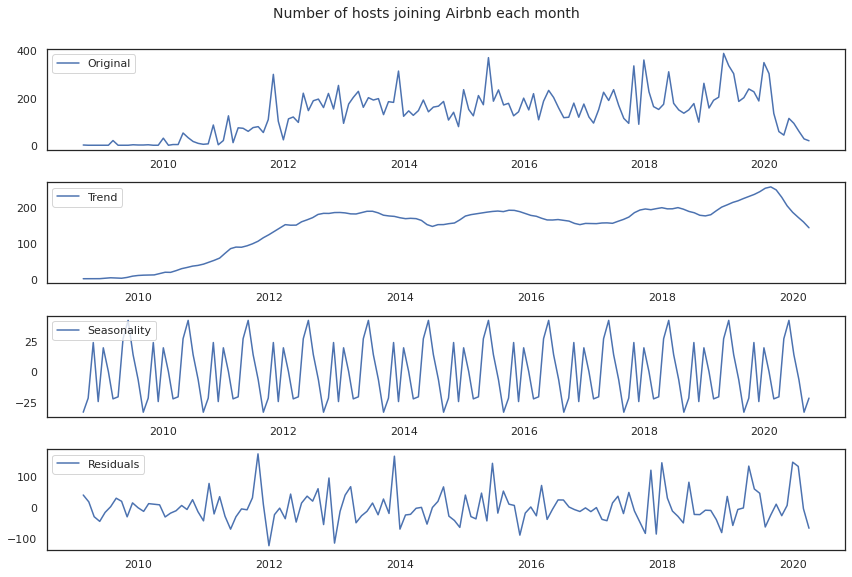

In [2185]:
ts_host_since = pd.DataFrame(df.set_index('host_since').resample('MS').size())
decompose_time_series(ts_host_since, title='Number of hosts joining Airbnb each month')

<b> host response time

In [2542]:
df.host_response_time.value_counts()

within an hour        4813
within a few hours    1929
within a day          1119
a few days or more     437
Name: host_response_time, dtype: int64

In [2543]:
df.host_response_time.fillna('unknown', inplace=True)

In [2544]:
col = 'host_response_time'
df = pd.concat([df.drop([col], axis=1), pd.get_dummies(df[col], drop_first=True, prefix=col)], axis=1)

<b> host acceptance rate

In [2545]:
sum(df.host_acceptance_rate=='100%')

5356

In [2546]:
sum(df.host_acceptance_rate<'50%')

5989

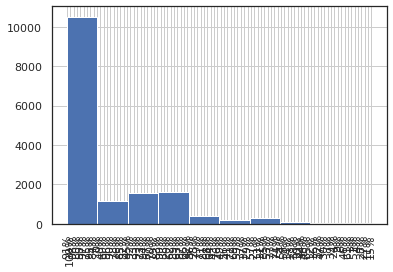

In [2264]:
# host accept rate is also less, lets bin it 
df.host_acceptance_rate.hist();
plt.xticks(rotation=90);

In [2547]:
df.host_acceptance_rate = df.host_acceptance_rate.str[:-1].astype('float64')
col = 'host_acceptance_rate'
bin_column(col,
            bins=[0, 50, 90, 99, 100], labels=['0-49%', '50-89%', '90-99%', '100%'],
            na_label='unknown')

In [2548]:
df = pd.concat([df.drop([col], axis=1), pd.get_dummies(df[col], drop_first=True, prefix=col)], axis=1)

In [2549]:
df.head()

,name,description,neighborhood_overview,host_url,host_name,host_since,host_location,host_about,host_response_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,sentiment,host_since_days,host_response_time_unknown,host_response_time_within a day,host_response_time_within a few hours,host_response_time_within an hour,host_acceptance_rate_100%,host_acceptance_rate_50-89%,host_acceptance_rate_90-99%,host_acceptance_rate_nan
0,Comf. double room/private bathroom,It is private double room with private bathroo...,NaN,https://www.airbnb.com/users/show/73163,Andres,2010-01-24,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",100%,0,El Gòtic,3.0,3.0,"['email', 'phone', 'reviews', 'manual_offline'...",1,1,NaN,el Barri Gòtic,Ciutat Vella,41.37973,2.17631,Private room in apartment,Private room,2,1 shared bath,1.0,1.0,"[""Kitchen"", ""Essentials"", ""Cable TV"", ""Air con...",$55.00,3,90,3.0,3.0,90.0,90.0,3.0,90.0,4,23,49,139,2020-10-13,2,0,0,2017-05-16,2017-11-06,100.0,10.0,10.0,10.0,10.0,10.0,10.0,HUTB-120440,0,3,1,2,0,0.05,1.000000,3914.0,0,0,1,0,0,0,1,0
1,Forum DeLuxe 5 mins Walk To CCIB Center & Sea★,"Beautiful apartment, large terrace, 5 minutes ...",Strategically located in the Parc del Fòrum ar...,https://www.airbnb.com/users/show/90417,Etain (Marnie),2010-03-09,"Catalonia, Spain","Hi. I'm Etain, though everyone calls me by my...",100%,1,El Besòs i el Maresme,6.0,6.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",1,1,"Sant Adria de Besos, Barcelona, Spain",el Besòs i el Maresme,Sant Martí,41.41291,2.22063,Entire apartment,Entire home/apt,6,2 baths,3.0,5.0,"[""Bed linens"", ""Cooking basics"", ""Heating"", ""L...",$180.00,3,1125,3.0,4.0,1125.0,1125.0,3.1,1125.0,30,60,90,358,2020-10-17,52,1,0,2011-03-15,2019-12-15,95.0,10.0,10.0,10.0,10.0,9.0,9.0,HUTB-005057,1,2,2,0,0,0.45,0.976744,3870.0,0,0,0,1,1,0,0,0
2,Sagrada Familia area - Còrsega 1,A lovely two bedroom apartment only 250 m from...,What's nearby <br />This apartment is located...,https://www.airbnb.com/users/show/135703,Nick,2010-05-31,"Barcelona, Catalonia, Spain",I'm Nick your English host in Barcelona.\r\n\r...,100%,0,Camp d'en Grassot i Gràcia Nova,5.0,5.0,"['email', 'phone', 'facebook', 'reviews', 'jum...",1,1,"Barcelona, Catalonia, Spain",el Camp d'en Grassot i Gràcia Nova,Gràcia,41.40566,2.17015,Entire apartment,Entire home/apt,6,1.5 baths,2.0,3.0,"[""Elevator"", ""Hot water"", ""Hangers"", ""Stove"", ...",$109.00,2,31,2.0,2.0,31.0,31.0,2.0,31.0,0,0,0,0,2020-10-15,63,5,0,2011-07-17,2020-02-22,86.0,9.0,9.0,10.0,10.0,10.0,9.0,HUTB-001722,1,5,5,0,0,0.56,0.857143,3787.0,0,0,0,1,0,0,1,0
3,Private Double room - Plaza Real,<b>The space</b><br />It is a Private double r...,NaN,https://www.airbnb.com/users/show/73163,Andres,2010-01-24,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",100%,0,El Gòtic,3.0,3.0,"['email', 'phone', 'reviews', 'manual_offline'...",1,1,NaN,el Barri Gòtic,Ciutat Vella,41.37916,2.17535,Private room in apartment,Private room,2,1 

4. Extract number of bathrooms from the bathroom text

In [2550]:
# dropping rows where bath info missing
df.dropna(subset=['bathrooms_text'], inplace=True)

In [2551]:
# extract no of bathrooms from text
import sys

def get_bath_counts(col):
    try:
        if 'half' in col or 'Half' in col:
            c = 0.5
        else:
            c = re.findall(r'\d+', col)[0]
    except:
        print(col)
        print(sys.exc_info()[0])
    return c

df['num_bathrooms'] = pd.to_numeric(df['bathrooms_text'].apply(lambda x: get_bath_counts(x)))

5. Process categorical variables of room type and neighbourhood.

In [2552]:
df['room_type'].value_counts()

Private room       6370
Entire home/apt    6134
Hotel room          257
Shared room          95
Name: room_type, dtype: int64

In [2553]:
df = pd.concat([df.drop(['room_type'], axis=1), pd.get_dummies(df['room_type'], drop_first=True)], axis=1)

In [2554]:
df = pd.concat([df.drop(['neighbourhood_group_cleansed'], axis=1), pd.get_dummies(df['neighbourhood_group_cleansed'], drop_first=True)], axis=1)

6. Identify relevance of other columns

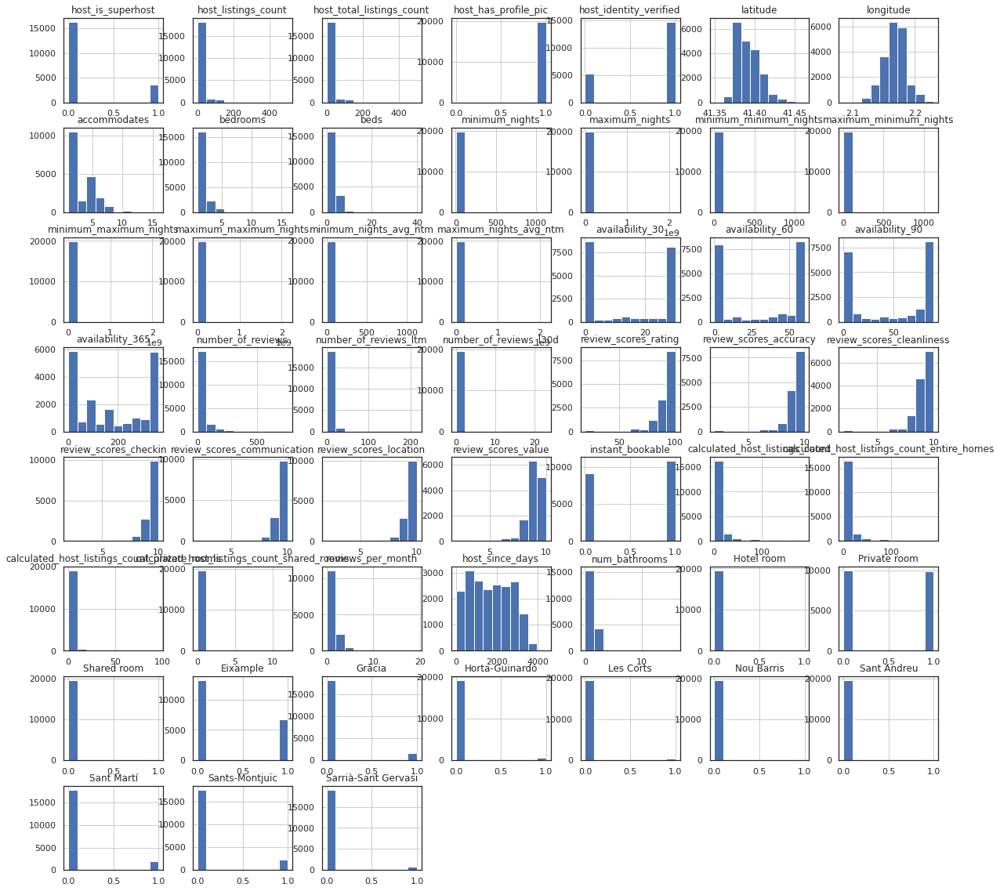

In [2191]:
df.hist(figsize=(20,20));

In [2555]:
cols_to_drop = ['host_has_profile_pic', 'minimum_minimum_nights', 'maximum_minimum_nights',
               'minimum_maximum_nights', 'maximum_maximum_nights', 'minimum_nights_avg_ntm',
               'maximum_nights_avg_ntm']
df.drop(cols_to_drop, axis=1, inplace=True)

Handle review rating columns

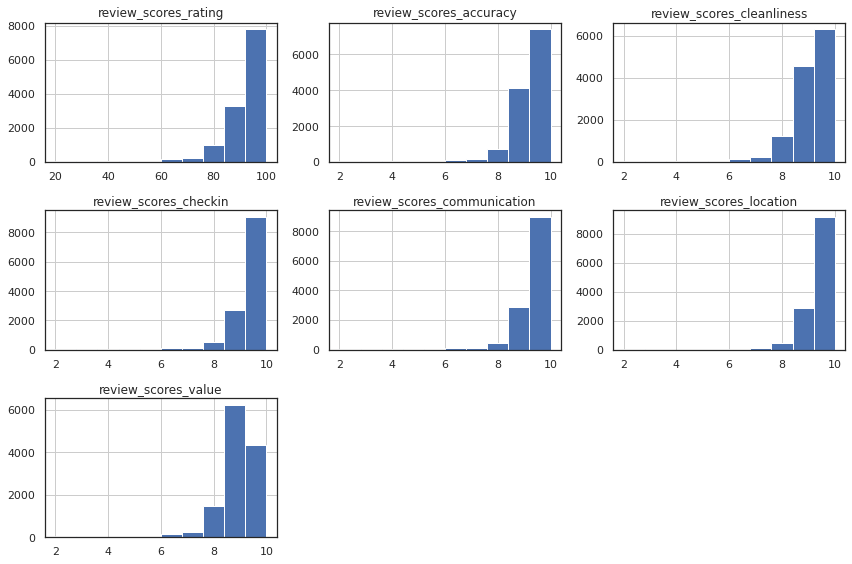

In [2556]:
# Checking the distributions of the review ratings columns
variables_to_plot = list(df.columns[df.columns.str.startswith("review_scores") == True])
fig = plt.figure(figsize=(12,8))
for i, var_name in enumerate(variables_to_plot):
    ax = fig.add_subplot(3,3,i+1)
    df[var_name].hist(bins=10,ax=ax)
    ax.set_title(var_name)
fig.tight_layout()
plt.show()

In [2557]:
variables_to_plot

['review_scores_rating',
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value']

In [2558]:
# Creating a list of all review columns that are scored out of 10
variables_to_plot.pop(0)
variables_to_plot.pop(0)

'review_scores_accuracy'

In [2559]:
# Binning for all columns scored out of 10
for col in variables_to_plot:
    bin_column(col,
               bins=[0, 8, 9, 10],
               labels=['0-8/10', '9/10', '10/10'],
               na_label='no reviews')

In [2560]:
df.review_scores_value.value_counts()

9/10      6235
10/10     4362
0-8/10    1996
nan        263
Name: review_scores_value, dtype: int64

In [2561]:
# label encode the review scores columns
# from sklearn.preprocessing import LabelEncoder, OrdinalEncoder

# oe = OrdinalEncoder(categories=[['nan','0-8/10', '9/10', '10/10']])

# for col in variables_to_plot:
#     df[col] = oe.fit_transform(df[[col]])

In [2562]:
# Binning column scored out of 100
bin_column('review_scores_rating',
           bins=[0, 80, 95, 100],
           labels=['0-79/100', '80-94/100', '95-100/100'],
           na_label='no reviews')

In [2563]:
df.review_scores_rating.value_counts()

80-94/100     6720
95-100/100    4797
0-79/100      1095
nan            244
Name: review_scores_rating, dtype: int64

In [2564]:
# df['review_scores_rating'] = le.fit_transform(df['review_scores_rating'].values)
# oe = OrdinalEncoder(categories=[['nan','0-79/100', '80-94/100', '95-100/100']])
# df['review_scores_rating'] = oe.fit_transform(df[['review_scores_rating']])

In [2565]:
variables_to_plot

['review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value']

In [2566]:
for col in variables_to_plot:
    df = pd.concat([df.drop([col], axis=1), pd.get_dummies(df[col], drop_first=True, prefix=col)], axis=1)

In [2567]:
df.columns

Index(['name', 'description', 'neighborhood_overview', 'host_url', 'host_name',
       'host_since', 'host_location', 'host_about', 'host_response_rate',
       'host_is_superhost', 'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_identity_verified', 'neighbourhood', 'neighbourhood_cleansed',
       'latitude', 'longitude', 'property_type', 'accommodates',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'availability_30',
       'availability_60', 'availability_90', 'availability_365',
       'calendar_last_scraped', 'number_of_reviews', 'number_of_reviews_ltm',
       'number_of_reviews_l30d', 'first_review', 'last_review',
       'review_scores_rating', 'review_scores_accuracy', 'license',
       'instant_bookable', 'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',


In [2568]:
df = pd.concat([df.drop(['review_scores_rating'], axis=1), pd.get_dummies(df['review_scores_rating'], drop_first=True, prefix='review_scores_rating')], axis=1)

Handle important columns such as bedrooms, beds, accomadates. Fill NAN with mean/median

In [2569]:
df.bedrooms

0        1.0
1        3.0
2        2.0
3        1.0
4        4.0
        ... 
12853    3.0
12854    1.0
12855    1.0
12856    2.0
12857    2.0
Name: bedrooms, Length: 12856, dtype: float64

In [2570]:
df['bedrooms'] = df['bedrooms'].fillna(df['bedrooms'].median())
df['beds'] = df['beds'].fillna(df['beds'].median())
df['reviews_per_month'] = df['reviews_per_month'].fillna(df['reviews_per_month'].median())

Log transform skewed columns

In [2571]:
mask = df.dtypes == np.float
float_cols = df.columns[mask]
float_cols

Index(['host_listings_count', 'host_total_listings_count', 'latitude',
       'longitude', 'bedrooms', 'beds', 'review_scores_accuracy',
       'reviews_per_month', 'sentiment', 'host_since_days', 'num_bathrooms'],
      dtype='object')

In [2572]:
# Create a list of float colums to check for skewing
mask = df.dtypes == np.float
float_cols = df.columns[mask]

skew_limit = 1 # define a limit above which we will log transform
skew_vals = df[float_cols].skew()

In [2573]:
# Showing the skewed columns
skew_cols = (skew_vals
             .sort_values(ascending=False)
             .to_frame()
             .rename(columns={0:'Skew'})
             .query('abs(Skew) > {}'.format(skew_limit)))

skew_cols

,Skew
host_total_listings_count,5.777265
host_listings_count,5.777265
num_bathrooms,3.814583
beds,2.400255
bedrooms,2.144768
reviews_per_month,2.119459
sentiment,-3.151738
review_scores_accuracy,-3.322644


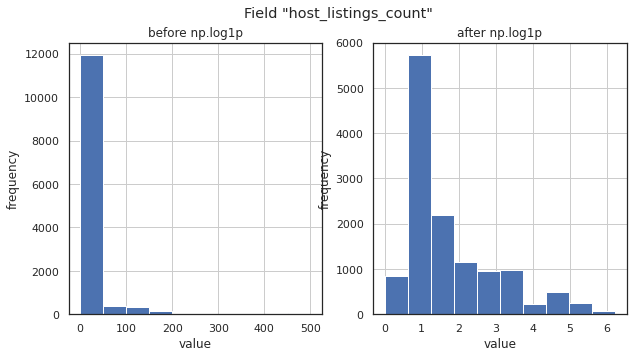

In [2574]:
# Let's look at what happens to one of these features, when we apply np.log1p visually.

# Choose a field
field = "host_listings_count"

# Create two "subplots" and a "figure" using matplotlib
fig, (ax_before, ax_after) = plt.subplots(1, 2, figsize=(10, 5))

# Create a histogram on the "ax_before" subplot
df[field].hist(ax=ax_before)

# Apply a log transformation (numpy syntax) to this column
df[field].apply(np.log1p).hist(ax=ax_after)

# Formatting of titles etc. for each subplot
ax_before.set(title='before np.log1p', ylabel='frequency', xlabel='value')
ax_after.set(title='after np.log1p', ylabel='frequency', xlabel='value')
fig.suptitle('Field "{}"'.format(field));

In [2575]:
# Perform the skew transformation:

for col in skew_cols.index.values:
    df[col] = df[col].apply(np.log1p)

- where are the properties located in Barcelona.

In [1429]:
from geopy.geocoders import Nominatim

address = 'Barcelona, Spain'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of New York City are 41.3828939, 2.1774322.


In [1435]:
df.head()

,name,description,neighborhood_overview,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_neighbourhood,host_listings_count,host_verifications,host_identity_verified,neighbourhood,neighbourhood_cleansed,latitude,longitude,accommodates,bathrooms_text,bedrooms,beds,amenities,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,num_bathrooms,Hotel room,Private room,Shared room,Eixample,Gràcia,Horta-Guinardó,Les Corts,Nou Barris,Sant Andreu,Sant Martí,Sants-Montjuïc,Sarrià-Sant Gervasi,has_kitchen,has_balcony,hotel,other,private_room,shared_room
0,Comf. double room/private bathroom,It is private double room with private bathroo...,NaN,https://www.airbnb.com/users/show/73163,Andres,2010-01-24,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",within a few hours,100%,91%,0,El Gòtic,3.0,"['email', 'phone', 'reviews', 'manual_offline'...",1,NaN,el Barri Gòtic,41.37973,2.17631,2,1 shared bath,1.0,1.0,"[""Kitchen"", ""Essentials"", ""Cable TV"", ""Air con...",55,3,90,4,23,49,139,2020-10-13,2,0,0,2017-05-16,2017-11-06,95-100/100,10/10,10/10,10/10,10/10,10/10,10/10,HUTB-120440,0,3,1,2,0,0.05,1.0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
1,Forum DeLuxe 5 mins Walk To CCIB Center & Sea★,"Beautiful apartment, large terrace, 5 minutes ...",Strategically located in the Parc del Fòrum ar...,https://www.airbnb.com/users/show/90417,Etain (Marnie),2010-03-09,"Catalonia, Spain","Hi. I'm Etain, though everyone calls me by my...",within an hour,100%,100%,1,El Besòs i el Maresme,6.0,"['email', 'phone', 'reviews', 'jumio', 'offlin...",1,"Sant Adria de Besos, Barcelona, Spain",el Besòs i el Maresme,41.41291,2.22063,6,2 baths,3.0,5.0,"[""Bed linens"", ""Cooking basics"", ""Heating"", ""L...",180,3,1125,30,60,90,358,2020-10-17,52,1,0,2011-03-15,2019-12-15,80-94/100,10/10,10/10,10/10,10/10,9/10,9/10,HUTB-005057,1,2,2,0,0,0.45,2.0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,0,0
2,Sagrada Familia area - Còrsega 1,A lovely two bedroom apartment only 250 m from...,What's nearby <br />This apartment is located...,https://www.airbnb.com/users/show/135703,Nick,2010-05-31,"Barcelona, Catalonia, Spain",I'm Nick your English host in Barcelona.\r\n\r...,within an hour,100%,98%,0,Camp d'en Grassot i Gràcia Nova,5.0,"['email', 'phone', 'facebook', 'reviews', 'jum...",1,"Barcelona, Catalonia, Spain",el Camp d'en Grassot i Gràcia Nova,41.40566,2.17015,6,1.5 baths,2.0,3.0,"[""Elevator"", ""Hot water"", ""Hangers"", ""Stove"", ...",109,2,31,0,0,0,0,2020-10-15,63,5,0,2011-07-17,2020-02-22,80-94/100,9/10,9/10,10/10,10/10,10/10,9/10,HUTB-001722,1,5,5,0,0,0.56,1.0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0
3,Private Double room - Plaza Real,<b>The space</b><br />It is a Private double r...,NaN,https://www.airbnb.com/users/show/73163,Andres,2010-01-24,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",within a few hours,100%,91%,0,El Gòtic,3.0,"['email', 'phone', 'reviews', 'manual_offline'...",1,NaN,el Barri Gòtic,41.37916,2.17535,2,1 private bath,1.0,1.0,"[""Kitchen"", ""Cable TV"", ""Air conditioning"", ""E...",40,30,240,0,0,0,0,2020-10-12,8,0,0,2010-07-10,2013-07-15,0-79/100,0-8/10,0-8/10,0-8/10,9/10,0-8/10,0-8/10,Exempt,0,3,1,2,0,0.06,1.0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
4,VIDRE HOME PLAZA REAL on LAS RAMBLAS,Spacious apartment for large families or group...,"Located in Ciutat Vella in the Gothic Quarter,...",https://www.airbnb.co

In [1437]:
import folium

# create map of Barcelona using latitude and longitude values
map_barca = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, neighborhood, private, shared, hotel in zip(df['latitude'], df['longitude'], df['neighbourhood_cleansed'], df['Private room'], df['Shared room'], df['Hotel room']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    if private == 1:
        folium.CircleMarker(
            [lat, lng],
            radius=2,
            popup=label,
            color='blue',
            fill=True,
            fill_color='#3186cc',
            fill_opacity=0.7,
            parse_html=False).add_to(map_barca) 
    elif shared==1:
        folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='yellow',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_barca) 

        
    elif private==0 and shared==0 and hotel==0:
        folium.CircleMarker(
        [lat, lng],
        radius=2,
        popup=label,
        color='red',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_barca)
    
map_barca

- Check for seasonality

host_listings_count

In [2576]:
sum((df.host_listings_count==df.host_total_listings_count)==False)

5

In [2577]:
df.drop(['host_total_listings_count'], axis=1, inplace=True)
df = df.dropna(subset=['host_listings_count'])

In [2578]:
# include potential important amenities
def amenity(col, amenity):
    try:
        if amenity in col:
            c = 1
        else:
            c = 0
    except:
        print(col)
        print(sys.exc_info()[0])
    return c

df['has_kitchen'] = pd.to_numeric(df['amenities'].apply(lambda x: amenity(x, 'Kitchen')))
df['has_balcony'] = pd.to_numeric(df['amenities'].apply(lambda x: amenity(x, 'balcony')))

In [2579]:
df.has_balcony.value_counts()

0    8288
1    4563
Name: has_balcony, dtype: int64

In [2580]:
df.has_kitchen.value_counts()

1    11190
0     1661
Name: has_kitchen, dtype: int64

In [2581]:
import ast
from collections import Counter

am_list=[]
for x in df.amenities.values:
    am_list.extend(ast.literal_eval(x))

c = Counter(am_list)
most_freq = [w for w,c in c.most_common()[:20]]
most_freq

['Wifi',
 'Essentials',
 'Kitchen',
 'Hair dryer',
 'Hangers',
 'Heating',
 'Iron',
 'Washer',
 'Hot water',
 'TV',
 'Shampoo',
 'Air conditioning',
 'Dishes and silverware',
 'Refrigerator',
 'Elevator',
 'Laptop-friendly workspace',
 'Microwave',
 'Coffee maker',
 'Cooking basics',
 'Bed linens']

In [2582]:
# add these to dataframe
for col in most_freq:
    df['has_'+col] = pd.to_numeric(df['amenities'].apply(lambda x: amenity(x, col)))

In [2583]:
categorical = df.select_dtypes(include=['object']).columns
df[categorical].head()

,name,description,neighborhood_overview,host_url,host_name,host_location,host_about,host_response_rate,host_neighbourhood,host_verifications,neighbourhood,neighbourhood_cleansed,property_type,bathrooms_text,amenities,price,calendar_last_scraped,first_review,last_review,license
0,Comf. double room/private bathroom,It is private double room with private bathroo...,NaN,https://www.airbnb.com/users/show/73163,Andres,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",100%,El Gòtic,"['email', 'phone', 'reviews', 'manual_offline'...",NaN,el Barri Gòtic,Private room in apartment,1 shared bath,"[""Kitchen"", ""Essentials"", ""Cable TV"", ""Air con...",$55.00,2020-10-13,2017-05-16,2017-11-06,HUTB-120440
1,Forum DeLuxe 5 mins Walk To CCIB Center & Sea★,"Beautiful apartment, large terrace, 5 minutes ...",Strategically located in the Parc del Fòrum ar...,https://www.airbnb.com/users/show/90417,Etain (Marnie),"Catalonia, Spain","Hi. I'm Etain, though everyone calls me by my...",100%,El Besòs i el Maresme,"['email', 'phone', 'reviews', 'jumio', 'offlin...","Sant Adria de Besos, Barcelona, Spain",el Besòs i el Maresme,Entire apartment,2 baths,"[""Bed linens"", ""Cooking basics"", ""Heating"", ""L...",$180.00,2020-10-17,2011-03-15,2019-12-15,HUTB-005057
2,Sagrada Familia area - Còrsega 1,A lovely two bedroom apartment only 250 m from...,What's nearby <br />This apartment is located...,https://www.airbnb.com/users/show/135703,Nick,"Barcelona, Catalonia, Spain",I'm Nick your English host in Barcelona.\r\n\r...,100%,Camp d'en Grassot i Gràcia Nova,"['email', 'phone', 'facebook', 'reviews', 'jum...","Barcelona, Catalonia, Spain",el Camp d'en Grassot i Gràcia Nova,Entire apartment,1.5 baths,"[""Elevator"", ""Hot water"", ""Hangers"", ""Stove"", ...",$109.00,2020-10-15,2011-07-17,2020-02-22,HUTB-001722
3,Private Double room - Plaza Real,<b>The space</b><br />It is a Private double r...,NaN,https://www.airbnb.com/users/show/73163,Andres,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",100%,El Gòtic,"['email', 'phone', 'reviews', 'manual_offline'...",NaN,el Barri Gòtic,Private room in apartment,1 private bath,"[""Kitchen"", ""Cable TV"", ""Air conditioning"", ""E...",$40.00,2020-10-12,2010-07-10,2013-07-15,Exempt
4,VIDRE HOME PLAZA REAL on LAS RAMBLAS,Spacious apartment for large families or group...,"Located in Ciutat Vella in the Gothic Quarter,...",https://www.airbnb.com/users/show/73163,Andres,"Barcelona, Catalonia, Spain","Hello I am a Professional designer, a traveler...",100%,El Gòtic,"['email', 'phone', 'reviews', 'manual_offline'...","Barcelona, Catalonia, Spain",el Barri Gòtic,Entire apartment,3 baths,"[""Elevator"", ""Hot water"", ""Host greets you"", ""...",$131.00,2020-10-15,2010-10-03,2020-03-11,HUTB-001506


Tackle 'property_type' variable 

In [2584]:
df.property_type.value_counts()

Private room in apartment             5604
Entire apartment                      5411
Entire loft                            232
Entire serviced apartment              198
Private room in house                  188
Private room in condominium            173
Entire condominium                     137
Room in boutique hotel                  96
Room in serviced apartment              79
Private room in guest suite             78
Private room in loft                    68
Room in hostel                          61
Room in hotel                           48
Private room in bed and breakfast       48
Entire house                            44
Shared room in hostel                   43
Shared room in apartment                38
Entire guest suite                      35
Private room in hostel                  32
Private room in serviced apartment      29
Boat                                    25
Private room                            22
Room in bed and breakfast               17
Private roo

In [2585]:
def bin_property_type(col):
    
    if 'Private' in col:
        val='private_room'
    elif 'Shared' in col:
        val='shared_room'
    elif 'Entire' in col:
        val='entire_space'
    elif 'hotel' in col or 'aparthotel' in col:
        val='hotel'
    elif 'Private' not in col or 'Shared' not in col or 'Entire' not in col or 'hotel' not in col or 'aparthotel' not in col:
        val='other'

    return val

df['property_type'] = df.property_type.apply(lambda x : bin_property_type(x))

In [2586]:
df.property_type.value_counts()

private_room    6314
entire_space    6097
other            192
hotel            153
shared_room       95
Name: property_type, dtype: int64

In [2587]:
df = pd.concat([df.drop(['property_type'], axis=1), pd.get_dummies(df['property_type'], drop_first=True)], axis=1)

7. Process the price column from string to numeric. Also remove outliers.

In [2588]:
# process price data
# process = lambda col: col.replace('$', '')
import re 
import string

def process(col):
#     val = col.replace('$', '')
    col = col.translate(str.maketrans('', '', ','))
    val = re.findall(r'\d+', col)[0]

    return val

df['price'] = pd.to_numeric(df['price'].apply(lambda x: process(x)))

In [2589]:
import plotly.figure_factory as ff

group_labels = ['distplot']
fig = ff.create_distplot([df.price.values], group_labels)
fig.show()
plt.show()

In [2590]:
len(df[df.price>1000]) # 14 outliers having price more than 2000 dolllars

20

In [2591]:
len(df[df.price<10])

6

In [2592]:
df = df.loc[(df.price<1000) & (df.price>10)]

In [1097]:
group_labels = ['distplot']
fig = ff.create_distplot([df.price.values], group_labels)
fig.show()
plt.show()

Q. How does price change with number of people?

In [2508]:
# df.groupby('accommodates').price.mean().plot(kind='bar') 
# plt.xlabel('No. of people')
# plt.ylabel('Mean price (dollars)')

x = df.groupby('accommodates').price.mean()
fig = go.Figure()
fig.add_trace(go.Bar(x=x.index, y=x.values, marker_color=px.colors.qualitative.Dark24[1]))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             size=15,
                             color="black"
                         ),
                         text='Mean price'
                     ),
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             size=15,
                             color="black"
                         ),
                         text='No. of people'
                     ),
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

Q. How much do the houses cost in certain neighbourhoods?

In [2501]:
# df.groupby('neighbourhood_cleansed').price.mean().plot(kind='bar', figsize=(15,5))
# plt.xlabel('Neighbourhood')
# plt.ylabel('Mean price (dollars)')

x = df.groupby('neighbourhood_cleansed').price.mean()
fig = go.Figure()
fig.add_trace(go.Bar(x=x.index, y=x.values, marker_color='#66c56c'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     title=dict(
                         font=dict(
                             # family="sans-serif",
                             # size=15,
                             color="black"
                         ),
                         text='Mean price'
                     ),
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
#                      tickvals=x.index,
#                      ticktext=x.index,
#                      title=dict(
#                          font=dict(
#                              # family="sans-serif",
#                              size=15,
#                              color="black"
#                          ),
#                          text='No. of people'
#                      ),
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

Q. How has the mean price changed over years?

<AxesSubplot:xlabel='host_since', ylabel='price'>

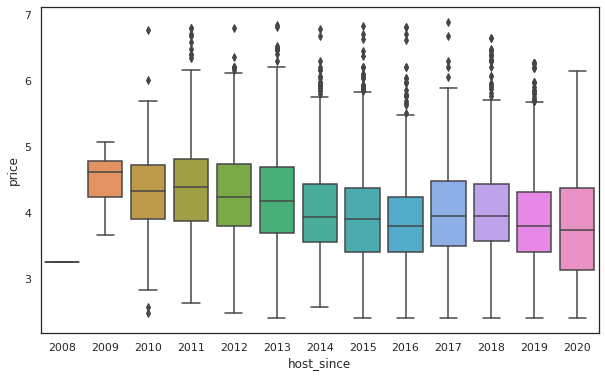

In [2424]:
plt.figure(figsize=(10,6))
sns.boxplot(df.host_since.dt.year, np.log(df.price))

8. Checking most important features

In [2593]:
corrs = df.corr()['price'].sort_values(ascending=False)[1:20]
fig = go.Figure()
fig.add_trace(go.Bar(x=corrs.index, y=corrs.values, marker_color='#23aaff'))
# fig.update_traces(marker_color='rgb(158,202,225)', marker_line_color='rgb(8,48,107)',
#                   marker_line_width=1.5, opacity=0.6)
fig.update_yaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_xaxes(automargin=True,
                     showline=True,
                     ticks='outside',
                     mirror=True,
                     linecolor='black',
                     linewidth=0.5,
                     color='black')
fig.update_layout(paper_bgcolor="white", plot_bgcolor='white')
fig.show()

In [2594]:
def multi_collinearity_heatmap(df, figsize=(11,9)):
    
    """
    Creates a heatmap of correlations between features in the df. A figure size can optionally be set.
    """
    
    # Set the style of the visualization
    sns.set(style="white")

    # Create a covariance matrix
    corr = df.corr()

    # Generate a mask the size of our covariance matrix
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=figsize)

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask, cmap=cmap, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5}, vmax=corr[corr != 1.0].max().max());

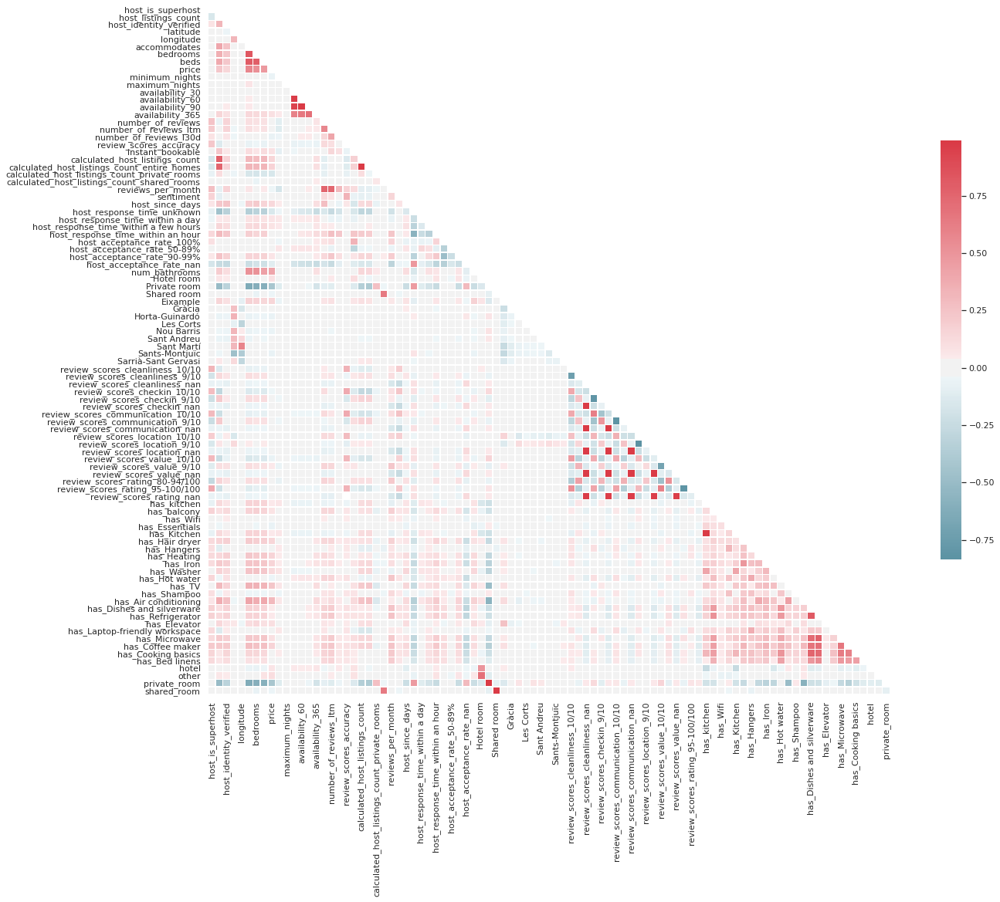

In [2595]:
multi_collinearity_heatmap(df, figsize=(20,20))

In [2596]:
df.shape

(12787, 111)

In [2597]:
df.select_dtypes(include = ['float', 'int', np.uint8]).columns

Index(['host_is_superhost', 'host_listings_count', 'host_identity_verified',
       'latitude', 'longitude', 'accommodates', 'bedrooms', 'beds', 'price',
       'minimum_nights', 'maximum_nights', 'availability_30',
       'availability_60', 'availability_90', 'availability_365',
       'number_of_reviews', 'number_of_reviews_ltm', 'number_of_reviews_l30d',
       'review_scores_accuracy', 'instant_bookable',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'reviews_per_month',
       'sentiment', 'host_since_days', 'host_response_time_unknown',
       'host_response_time_within a day',
       'host_response_time_within a few hours',
       'host_response_time_within an hour', 'host_acceptance_rate_100%',
       'host_acceptance_rate_50-89%', 'host_acceptance_rate_90-99%',
       'host_acceptance_rate_nan', 'num_bathrooms', 'Hotel ro

In [2598]:
# pd.set_option("display.max_columns", 100)
numerics = df.select_dtypes(include = ['float', 'int', np.uint8]).columns
df[numerics].head()

,host_is_superhost,host_listings_count,host_identity_verified,latitude,longitude,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_accuracy,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month,sentiment,host_since_days,host_response_time_unknown,host_response_time_within a day,host_response_time_within a few hours,host_response_time_within an hour,host_acceptance_rate_100%,host_acceptance_rate_50-89%,host_acceptance_rate_90-99%,host_acceptance_rate_nan,num_bathrooms,Hotel room,Private room,Shared room,Eixample,Gràcia,Horta-Guinardó,Les Corts,Nou Barris,Sant Andreu,Sant Martí,Sants-Montjuïc,Sarrià-Sant Gervasi,review_scores_cleanliness_10/10,review_scores_cleanliness_9/10,review_scores_cleanliness_nan,review_scores_checkin_10/10,review_scores_checkin_9/10,review_scores_checkin_nan,review_scores_communication_10/10,review_scores_communication_9/10,review_scores_communication_nan,review_scores_location_10/10,review_scores_location_9/10,review_scores_location_nan,review_scores_value_10/10,review_scores_value_9/10,review_scores_value_nan,review_scores_rating_80-94/100,review_scores_rating_95-100/100,review_scores_rating_nan,has_kitchen,has_balcony,has_Wifi,has_Essentials,has_Kitchen,has_Hair dryer,has_Hangers,has_Heating,has_Iron,has_Washer,has_Hot water,has_TV,has_Shampoo,has_Air conditioning,has_Dishes and silverware,has_Refrigerator,has_Elevator,has_Laptop-friendly workspace,has_Microwave,has_Coffee maker,has_Cooking basics,has_Bed linens,hotel,other,private_room,shared_room
0,0,1.386294,1,41.37973,2.17631,2,0.693147,0.693147,55,3,90,4,23,49,139,2,0,0,2.397895,0,3,1,2,0,0.048790,0.693147,3914.0,0,0,1,0,0,0,1,0,0.693147,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,1,1,1,0,0,1,0,1,0,1,0,1,0,0,1,0,0,0,0,0,0,0,1,0
1,1,1.945910,1,41.41291,2.22063,6,1.386294,1.791759,180,3,1125,30,60,90,358,52,1,0,2.397895,1,2,2,0,0,0.371564,0.681451,3870.0,0,0,0,1,1,0,0,0,1.098612,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,1,0,0,0,1,0,0,1,0,1,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,0,0,0,0
2,0,1.791759,1,41.40566,2.17015,6,1.098612,1.386294,109,2,31,0,0,0,0,63,5,0,2.302585,1,5,5,0,0,0.444686,0.619039,3787.0,0,0,0,1,0,0,1,0,0.693147,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0,0
3,0,1.386294,1,41.37916,2.17535,2,0.693147,0.693147,40,30,240,0,0,0,0,8,0,0,2.197225,0,3,1,2,0,0.058269,0.693147,3914.0,0,0,1,0,0,0,1,0,0.693147,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,0,0,0,1,0,1,1,1,1,0,1,1,1,0,0,0,1,0
4,0,1.386294,1,41.37978,2.17623,9,1.609438,1.945910,131,4,365,0,0,2,92,149,7,0,2.397895,1,3,1,2,0,0.797507,0.659531,3914.0,0,0,1,0,0,0,1,0,1.386294,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,1,0,1,0,0,1,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,0


In [2599]:
num_vars = df[numerics]

In [2600]:
num_vars.isna().sum().sort_values(ascending=False)

review_scores_accuracy                          254
shared_room                                       0
host_acceptance_rate_90-99%                       0
sentiment                                         0
host_since_days                                   0
host_response_time_unknown                        0
host_response_time_within a day                   0
host_response_time_within a few hours             0
host_response_time_within an hour                 0
host_acceptance_rate_100%                         0
host_acceptance_rate_50-89%                       0
host_acceptance_rate_nan                          0
calculated_host_listings_count_shared_rooms       0
num_bathrooms                                     0
Hotel room                                        0
Private room                                      0
Shared room                                       0
Eixample                                          0
Gràcia                                            0
Horta-Guinar

In [2601]:
# fill nulls with mean
# fill_mean = lambda col: col.fillna(col.mean())
# num_vars = num_vars.apply(fill_mean)
num_vars.dropna(how='any', inplace=True)

In [2602]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

X = num_vars.drop(['price'], axis=1)
y = num_vars['price']

# Scaling
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [2603]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error

cols = ['host_is_superhost', 'host_listings_count','minimum_nights', 'maximum_nights', 'accommodates', 'bedrooms', 'beds', 'num_bathrooms', 'Hotel room', 'Private room', 'Shared room',
       'Eixample', 'Gràcia', 'Horta-Guinardó', 'Les Corts', 'Nou Barris',
       'Sant Andreu', 'Sant Martí', 'Sants-Montjuïc', 'Sarrià-Sant Gervasi', 'latitude', 'longitude' ]


model = LinearRegression(normalize=True)

model.fit(X_train, y_train)
pred = model.predict(X_test)

print("r squared:", r2_score(y_test, pred))
print("mean squared:", mean_squared_error(y_test, pred))

r squared: -1291360.5377599248
mean squared: 8819018820.925016


In [2604]:
X.shape

(12533, 91)

In [2605]:
from sklearn.ensemble import GradientBoostingRegressor

model = GradientBoostingRegressor()

model.fit(X_train, y_train)
pred = model.predict(X_test)

print("r squared:", r2_score(y_test, pred))
print("mean squared:", mean_squared_error(y_test, pred))

r squared: 0.553563575939388
mean squared: 3048.821814041782


In [2606]:
from xgboost import XGBRegressor

xgb_model = XGBRegressor(
    max_depth=10,
    n_estimators=1000,
    min_child_weight=0.5, 
    colsample_bytree=0.8, 
    subsample=0.8, 
    eta=0.1,
    seed= 48  #32
)

xgb_model.fit(
    X_train, 
    y_train)

XGBRegressor(colsample_bytree=0.8, eta=0.1, max_depth=10, min_child_weight=0.5,
             n_estimators=1000, seed=48, subsample=0.8)

In [2607]:
xg_pred = xgb_model.predict(X_test)

print("r squared:", r2_score(y_test, xg_pred))
print("mean squared:", mean_squared_error(y_test, xg_pred))

r squared: 0.6427799982707076
mean squared: 2439.5413881741074


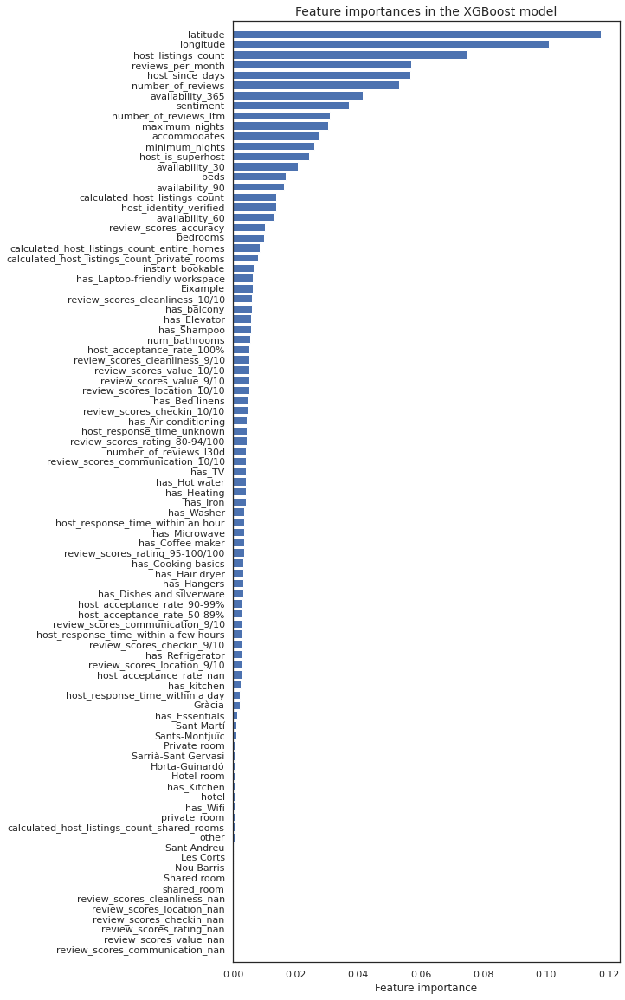

In [2608]:
# Producing a dataframe of feature importances
ft_weights_xgb_reg = pd.DataFrame(xgb_model.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg.sort_values('weight', inplace=True)

# Plotting feature importances
plt.figure(figsize=(8,20))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.title("Feature importances in the XGBoost model", fontsize=14)
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()

In [2342]:
listings.describe()

,id,scrape_id,host_id,host_listings_count,host_total_listings_count,latitude,longitude,accommodates,bathrooms,bedrooms,beds,minimum_nights,maximum_nights,minimum_minimum_nights,maximum_minimum_nights,minimum_maximum_nights,maximum_maximum_nights,minimum_nights_avg_ntm,maximum_nights_avg_ntm,calendar_updated,availability_30,availability_60,availability_90,availability_365,number_of_reviews,number_of_reviews_ltm,number_of_reviews_l30d,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,1.989600e+04,1.989600e+04,1.989600e+04,19889.000000,19889.000000,19896.000000,19896.000000,19896.000000,0.0,19191.000000,19477.000000,19896.000000,1.989600e+04,19895.000000,19895.000000,1.989500e+04,1.989500e+04,19895.000000,1.989500e+04,0.0,19896.000000,19896.000000,19896.000000,19896.000000,19896.000000,19896.000000,19896.000000,13773.000000,13758.000000,13759.000000,13754.000000,13760.000000,13755.000000,13754.000000,19896.000000,19896.000000,19896.000000,19896.000000,14019.000000
mean,2.623752e+07,2.020101e+13,1.116437e+08,17.481724,17.481724,41.392010,2.167450,3.279704,NaN,1.606534,2.231504,11.369471,2.165771e+05,11.227344,12.368334,3.246199e+05,3.246386e+05,11.755406,3.246312e+05,NaN,14.469743,30.906162,47.981856,175.013219,32.143245,4.506333,0.123894,91.309446,9.392935,9.238244,9.571107,9.560610,9.622610,9.069943,15.565239,12.893245,2.393144,0.077252,1.104917
std,1.410381e+07,3.464931e+00,1.131167e+08,42.836902,42.836902,0.014767,0.017834,2.207352,NaN,0.985247,1.925645,27.761671,2.153034e+07,26.512639,27.855808,2.636917e+07,2.636917e+07,26.787103,2.636917e+07,NaN,13.726528,27.452272,40.377179,147.254649,63.002981,8.897080,0.613315,10.569594,1.058436,1.124760,0.954157,0.979826,0.811523,1.103879,32.628737,31.360891,9.039031,0.770539,1.239922
min,2.197400e+04,2.020101e+13,3.073000e+03,0.000000,0.000000,41.349670,2.085520,1.000000,NaN,1.000000,0.000000,1.000000,1.000000e+00,1.000000,1.000000,1.000000e+00,1.000000e+00,1.000000,1.000000e+00,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,20.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.010000
25%,1.502803e+07,2.020101e+13,9.556679e+06,1.000000,1.000000,41.380460,2.156848,2.000000,NaN,1.000000,1.000000,1.000000,9.900000e+01,1.000000,2.000000,3.300000e+02,3.300000e+02,1.500000,3.300000e+02,NaN,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,88.000000,9.000000,9.000000,9.000000,9.000000,9.000000,9.000000,1.000000,0.000000,0.000000,0.000000,0.190000
50%,2.789544e+07,2.020101e+13,6.186534e+07,2.000000,2.000000,41.389040,2.168455,2.000000,NaN,1.000000,2.000000,3.000000,1.125000e+03,2.000000,3.000000,1.125000e+03,1.125000e+03,3.000000,1.125000e+03,NaN,13.000000,41.000000,65.000000,167.000000,4.000000,1.000000,0.000000,94.000000,10.000000,10.000000,10.000000,10.000000,10.000000,9.000000,3.000000,1.000000,1.000000,0.000000,0.630000
75%,3.949680e+07,2.020101e+13,1.992768e+08,12.000000,12.000000,41.401902,2.178020,4.000000,NaN,2.000000,3.000000,29.000000,1.125000e+03,28.000000,30.000000,1.125000e+03,1.125000e+03,30.000000,1.125000e+03,NaN,29.000000,59.000000,89.000000,346.000000,34.000000,5.000000,0.000000,98.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,12.000000,8.000000,2.000000,0.000000,1.660000
max,4.582763e+07,2.020101e+13,3.713705e+08,501.000000,501.000000,41.462440,2.230370,16.000000,NaN,16.000000,40.000000,1124.000000,2.147484e+09,1123.000000,1124.000000,2.147484e+09,2.147484e+09,1123.000000,2.147484e+09,NaN,30.000000,60.000000,90.000000,365.000000,761.000000,215.000000,23.000000,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,188.000000,188.000000,96.000000,12.000000,19.29000